# 라이브러리 임포트

In [ ]:
import os, tqdm, math, random, argparse

import numpy as np
import pandas as pd

from glob import glob
from PIL import Image
from matplotlib import pyplot as plt

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torchvision.transforms.functional as TF
from torch.utils.data import DataLoader, Dataset

from tqdm.notebook import tqdm

import segmentation_models_pytorch as smp

from collections import Counter

# CUDA 설정

In [ ]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
device = torch.device(device)
print(device)

cuda:0


# 데이터 로드

In [ ]:
train_img = glob('/data/dacon/all_img_2/train/train_input/*.npy')
label_img = glob('/data/dacon/all_img_2/train/train_label/*.npy')
val_train_img = glob('/data/dacon/all_img_2/val/val_input/*.npy')
val_label_img = glob('/data/dacon/all_img_2/val/val_label/*.npy')
test_img = sorted(glob('/data/chgo/test_input_img/*.png'))
print(len(train_img), len(label_img), len(val_train_img), len(val_train_img))

52978 52978 10140 10140


# Custom dataset

In [ ]:
# 높이 3 너비 4
# width 4 height 3

class CustomDataset(Dataset):
    def __init__(self, data, label,is_train=True):
        self.data  = data
        self.label = label
        self.is_train = is_train
        
    def __len__(self):
        return len(self.data)
    
    def transform(self, image, label):
        
        transform = transforms.Compose([
            transforms.ToTensor(),
        ])
        
        image = transform(image)
        label = transform(label)
        
        return image, label
    
    def __getitem__(self, idx):
        
        inp = np.load(self.data[idx])
        inp = inp.astype(np.float32)/255
        targ = np.load(self.label[idx])
        targ = targ.astype(np.float32)/255
        
        origin_img, label_img = self.transform(inp, targ)
        return origin_img, label_img

In [ ]:
class testDataset(Dataset):
    def __init__(self, data,is_train=True):
        self.data  = data
        self.is_train = is_train
        
    def __len__(self):
        return len(self.data)
    
    def transform(self, image):
        
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((2048, 3072))
        ])
        image = transform(image)
        
        return image
    
    def __getitem__(self, idx):
        origin_img = Image.open(self.data[idx])
        
        origin_img = self.transform(origin_img)
        return origin_img

In [ ]:
train_dataset = CustomDataset(train_img, label_img)
vaild_dataset = CustomDataset(val_train_img, val_label_img)
test_dataset = testDataset(test_img)

In [ ]:
train_loader = DataLoader(train_dataset , batch_size = 32, shuffle = True)
vaild_loader = DataLoader(vaild_dataset , batch_size = 32, shuffle = True)
test_loader = DataLoader(test_dataset , batch_size = 1, shuffle = False )

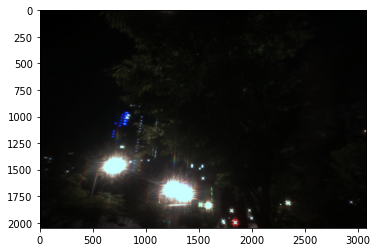

In [ ]:
plt.imshow(np.transpose(test_dataset[0], (1, 2, 0)))

# model

In [ ]:
model = smp.UnetPlusPlus(encoder_name='efficientnet-b4',
                encoder_weights='imagenet',
                in_channels=3, classes=3, activation='sigmoid')

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b4-6ed6700e.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b4-6ed6700e.pth


# 학습

In [ ]:
criterion = nn.MSELoss().to(device)
model = model.to(device)

opt = torch.optim.Adam([param for param in model.parameters() if param.requires_grad], lr=0.01)
scheduler = torch.optim.lr_scheduler.StepLR(opt,step_size = 10, gamma = 0.8)

## 평가 함수

In [ ]:
def evaluate(model, val_load):
    model.eval()
    
    val_loss = 0

    
    with torch.no_grad():
        for data, label in val_load:
            data = data.to(device)
            label = label.to(device)
            
            output = model(data)
            
            loss = torch.sqrt(criterion(output, label))
            val_loss += loss.item()
            
            
        val_loss /= len(val_load)
    
    return val_loss

## 학습 코드

In [ ]:
# label값을 tensor로 바꾼후 model을 예측을 max로 바꾼후 loss 계산
from tqdm import tqdm

train_loss = []

val_loss = []


for epoch in range(30):
    model.train()

    cost = 0
    
    epoch_loss = 0
    

    for batch, train in tqdm(enumerate(train_loader), total=len(train_loader)):
        data, label = train
        
        data = data.to(device)
        
        label = label.to(device)
        
        opt.zero_grad()
        
        out = model(data)
        
        loss = torch.sqrt(criterion(out, label))
        
        cost += loss.item()
        
        loss.backward()
        opt.step()
        
        
    epoch_loss = cost / len(train_loader)
    
    train_loss.append(epoch_loss)
    
    loss_val = evaluate(model, vaild_loader)
    val_loss.append(loss_val)
    
    print(f'epoch : {epoch+1}\t Loss : {epoch_loss:.6f}\t val_loss : {loss_val:.6f}')
    
    if epoch % 10 == 0:
        torch.save(model, './model/unet_efficientnet-b4_'+ str(epoch) +'.pt')
    

    scheduler.step()

  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 1	 Loss : 0.069162	 val_loss : 0.000218


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 2	 Loss : 0.056092	 val_loss : 0.000231


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 3	 Loss : 0.051691	 val_loss : 0.000368


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 4	 Loss : 0.049000	 val_loss : 0.000256


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 5	 Loss : 0.047336	 val_loss : 0.000156


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 6	 Loss : 0.045136	 val_loss : 0.000204


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 7	 Loss : 0.044438	 val_loss : 0.000223


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 8	 Loss : 0.043374	 val_loss : 0.000325


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 9	 Loss : 0.042405	 val_loss : 0.000149


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 10	 Loss : 0.042098	 val_loss : 0.000236


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 11	 Loss : 0.038387	 val_loss : 0.000157


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 12	 Loss : 0.036583	 val_loss : 0.000158


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 13	 Loss : 0.035758	 val_loss : 0.000197


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 14	 Loss : 0.035200	 val_loss : 0.000167


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 15	 Loss : 0.034376	 val_loss : 0.000169


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 16	 Loss : 0.034038	 val_loss : 0.000167


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 17	 Loss : 0.033382	 val_loss : 0.000161


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 18	 Loss : 0.033212	 val_loss : 0.000185


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 19	 Loss : 0.032724	 val_loss : 0.000196


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 20	 Loss : 0.032240	 val_loss : 0.000160


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 21	 Loss : 0.031194	 val_loss : 0.000235


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 22	 Loss : 0.030693	 val_loss : 0.000117


  0%|                                                                                                                                                             | 0/1656 [00:00<?, ?it/s]

epoch : 23	 Loss : 0.030562	 val_loss : 0.000153


 48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 790/1656 [24:34<26:55,  1.87s/it]


KeyboardInterrupt: 

# 학습 시각화

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt

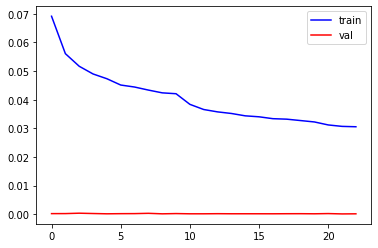

In [ ]:
plt.plot(train_loss, 'b', label='train')
plt.plot(val_loss, 'r', label='val')
plt.legend()
plt.show()

# test img

In [ ]:
def test_visual(img, idx):

    f,axes= plt.subplots(1,2,figsize=(512,256))
    axes[0].set_title("Original Image")
    axes[1].set_title("output Image")

    axes[0].imshow(np.transpose(img, (1, 2, 0)))
    
    pred = Image.open(f'./submission/efficientnet/test_{20000+idx}.png')
    axes[1].imshow(pred)
    plt.show()

In [ ]:
idx = 15
img = test_loader.dataset[idx]
test_visual(img, idx)

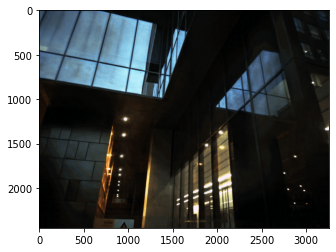

In [ ]:
a = Image.open(f'./submission/mobilenet/test_{20000+idx}.png')
a = transforms.Resize((2448, 3264))(a)
plt.imshow(a)